In [ ]:
!pip install numpy==1.26.4 opencv-contrib-python==4.9.0.80 matplotlib

In [1]:
import cv2 as cv
import numpy as np
import glob
import matplotlib.pyplot as plt

# --------------------- config ---------------------
RATIO_TEST = 0.75
RANSAC_THRESH = 3.0
RESIZE_MAX = 1000  # downscale for speed
# --------------------------------------------------

def show_img(img, title=""):
    plt.figure(figsize=(10,6))
    if img.ndim == 2:
        plt.imshow(img, cmap="gray")
    else:
        plt.imshow(cv.cvtColor(img.astype(np.uint8), cv.COLOR_BGR2RGB))
    plt.title(title); plt.axis("off"); plt.show()

def draw_polys_debug(canvas_size, images, H_to_anchor, canvas_T):
    vis = np.zeros((canvas_size[1], canvas_size[0], 3), np.uint8)
    for i, (img, H) in enumerate(zip(images, H_to_anchor)):
        h, w = img.shape[:2]
        cs = np.float32([[0,0],[w,0],[w,h],[0,h]]).reshape(-1,1,2)
        wc = cv.perspectiveTransform(cs, canvas_T @ H).reshape(-1,2).astype(np.int32)
        cv.polylines(vis, [wc.reshape(-1,1,2)], True, (0,255,0), 2)
        cx, cy = wc.mean(axis=0).astype(int)
        cv.putText(vis, str(i), (cx, cy), cv.FONT_HERSHEY_SIMPLEX, 1, (0,0,255), 2)
    show_img(vis, "Warped footprints with IDs")

def imread_color(p):
    img = cv.imread(str(p), cv.IMREAD_COLOR)
    if img is None:
        raise RuntimeError(f"Failed to read {p}")
    if RESIZE_MAX is not None:
        h, w = img.shape[:2]
        s = RESIZE_MAX / max(h, w)
        if s < 1.0:
            img = cv.resize(img, (int(w*s), int(h*s)), interpolation=cv.INTER_AREA)
    return img

def to_gray(img):
    return cv.cvtColor(img, cv.COLOR_BGR2GRAY)


In [ ]:
def detect_and_match(imgA, imgB, idxA=None, idxB=None, visualize=False):
    sift = cv.SIFT_create(nfeatures=4000, contrastThreshold=0.02, edgeThreshold=10)
    grayA, grayB = to_gray(imgA), to_gray(imgB)
    kA, dA = sift.detectAndCompute(grayA, None)
    kB, dB = sift.detectAndCompute(grayB, None)

    if dA is None or dB is None or len(kA) < 8 or len(kB) < 8:
        return None, None, None, None

    flann = cv.FlannBasedMatcher(dict(algorithm=1, trees=5), dict(checks=100))
    raw = flann.knnMatch(dA, dB, k=2)
    good = [m for m,n in raw if m.distance < RATIO_TEST * n.distance]

    if len(good) < 8:
        return None, None, None, None

    ptsA = np.float32([kA[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
    ptsB = np.float32([kB[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)
    H, mask = cv.findHomography(ptsA, ptsB, cv.RANSAC, RANSAC_THRESH)

    if idxA is not None and idxB is not None:
        inliers = int(mask.sum()) if mask is not None else 0
        print(f"[match] {idxA} -> {idxB} : {len(good)} matches, {inliers} inliers")

    if visualize:
        # matched_vis = cv.drawMatches(imgA, kA, imgB, kB, good[:50], None,
                                     flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        # show_img(matched_vis, f"Matches {idxA}->{idxB}")

    return H, mask, ptsA, ptsB


In [3]:
def _normalize_H(H):
    if H is None:
        return None
    if abs(H[2,2]) < 1e-12:
        return H
    return H / H[2,2]

def accumulate_homographies(images):
    """
    Build transforms that map each image into the center (anchor) frame.
    We estimate pairwise homographies in the direction (neighbor -> current)
    and compose DIRECTLY without inverting.
    """
    N = len(images)
    center = N // 2
    H_to_anchor = [None] * N
    H_to_anchor[center] = np.eye(3, dtype=np.float64)

    # ---- forward: center -> right ----
    # For pair (i, i+1): estimate H(i+1 -> i) and compose:
    # H_to_anchor[i+1] = H_to_anchor[i] @ H(i+1 -> i)
    for i in range(center, N - 1):
        H, _, _, _ = detect_and_match(images[i + 1], images[i], i+1, i, visualize=True)  # H: (i+1)->i
        H = _normalize_H(H)
        if H is None:
            print(f"[warn] Not enough matches between {i} and {i+1} (right). Propagating pose.")
            H_to_anchor[i + 1] = H_to_anchor[i] if H_to_anchor[i + 1] is None else H_to_anchor[i + 1]
        else:
            H_to_anchor[i + 1] = H_to_anchor[i] @ H
            print(f"[merge] merged image {i+1} into canvas")

    # ---- backward: center -> left ----
    # For pair (i-1, i): estimate H(i-1 -> i) and compose:
    # H_to_anchor[i-1] = H_to_anchor[i] @ H(i-1 -> i)
    for i in range(center, 0, -1):
        H, _, _, _ = detect_and_match(images[i - 1], images[i], i-1, i, visualize=True)  # H: (i-1)->i
        H = _normalize_H(H)
        if H is None:
            print(f"[warn] Not enough matches between {i-1} and {i} (left). Propagating pose.")
            H_to_anchor[i - 1] = H_to_anchor[i] if H_to_anchor[i - 1] is None else H_to_anchor[i - 1]
        else:
            H_to_anchor[i - 1] = H_to_anchor[i] @ H
            print(f"[merge] merged image {i-1} into canvas")

    return H_to_anchor, center


In [4]:
PADDING = 80  # safety margin in pixels

def compute_canvas_bounds(images, H_to_anchor):
    corners = []
    polys   = []
    for img, H in zip(images, H_to_anchor):
        h, w = img.shape[:2]
        cs = np.float32([[0,0],[w,0],[w,h],[0,h]]).reshape(-1,1,2)
        wc = cv.perspectiveTransform(cs, H)  # 4x1x2
        corners.append(wc)
        polys.append(wc.reshape(-1,2))       # 4x2 for drawing/debug

    allc = np.vstack(corners)                # (4N,1,2)
    x_min, y_min = np.floor(allc.min(axis=0).ravel()).astype(int)
    x_max, y_max = np.ceil (allc.max(axis=0).ravel()).astype(int)

    # padding
    x_min -= PADDING
    y_min -= PADDING
    x_max += PADDING
    y_max += PADDING

    T = np.array([[1,0,-x_min],[0,1,-y_min],[0,0,1]], dtype=np.float64)
    size = (int(x_max - x_min), int(y_max - y_min))
    return T, size, polys  # return polys for debug drawing


In [5]:
def multiband_blend_warped(images, H_to_anchor, canvas_T, canvas_size, debug_show=False):
    print("[info] overlap-aware feather blending (fixed edges)")

    Hs = [canvas_T @ H for H in H_to_anchor]

    canvas = np.zeros((canvas_size[1], canvas_size[0], 3), np.float32)
    weight = np.zeros((canvas_size[1], canvas_size[0], 1), np.float32)
    cover_count = np.zeros((canvas_size[1], canvas_size[0], 1), np.float32)

    warped_imgs, warped_masks = [], []

    # First pass: warp all images
    for i, (img, Hc) in enumerate(zip(images, Hs)):
        warped = cv.warpPerspective(img, Hc, canvas_size).astype(np.float32)
        mask = (warped.sum(axis=2, keepdims=True) > 0).astype(np.float32)

        warped_imgs.append(warped)
        warped_masks.append(mask)
        cover_count += mask

        if debug_show:
            show_img(warped.astype(np.uint8), f"Warped image {i}")

    # Second pass: compute per-image weights
    for i, (warped, mask) in enumerate(zip(warped_imgs, warped_masks)):
        single = ((cover_count == 1.0) & (mask == 1.0)).astype(np.float32)  # unique coverage
        overlap = ((cover_count > 1.0) & (mask == 1.0)).astype(np.float32)  # overlap coverage

        # start with full weight in unique regions
        w = single

        # feather only in overlap
        if overlap.any():
            dist = cv.distanceTransform((mask.squeeze()*255).astype(np.uint8), cv.DIST_L2, 3)
            if dist.max() > 0:
                dist = (dist / dist.max())[:,:,None]
            else:
                dist = np.zeros_like(mask)
            w += overlap * (0.05 + 0.95 * dist)

        # boost edge images (first & last in sequence)
        if i == 0 or i == len(images)-1:
            w *= 1.2

        canvas += warped * w
        weight += w

        if debug_show:
            show_img((w*255).astype(np.uint8).squeeze(), f"Weight mask {i}")

    out = np.clip(canvas / (weight + 1e-6), 0, 255).astype(np.uint8)

    if debug_show:
        show_img(out, "Final blended mosaic")

    return out


In [6]:
def stitch_folder_split(folder_glob, out_prefix="mosaic"):
    files = sorted(glob.glob(folder_glob))
    if not files:
        raise SystemExit("No images found")

    imgs = [imread_color(f) for f in files]
    print(f"[info] loaded {len(imgs)} images")

    # Break into subgroups whenever matches fail
    subgroups = []
    
    current = [imgs[0]]

    for i in range(1, len(imgs)):
        H, _, _, _ = detect_and_match(imgs[i], imgs[i-1], i, i-1)
        if H is None:
            print(f"[split] No match between {i-1} and {i} → splitting mosaic here")
            subgroups.append(current)
            current = [imgs[i]]
        else:
            current.append(imgs[i])
    subgroups.append(current)

    print(f"[info] formed {len(subgroups)} mosaics")

    # Stitch each subgroup
    for gi, group in enumerate(subgroups):
        if len(group) < 2:
            print(f"[skip] group {gi} has only 1 image")
            continue

        print(f"[info] stitching group {gi} with {len(group)} images")
        H_to_anchor, _ = accumulate_homographies(group)
        T, canvas_size = compute_canvas_bounds(group, H_to_anchor)
        print(f"[info] group {gi} canvas size: {canvas_size}")

        mosaic = multiband_blend_warped(group, H_to_anchor, T, canvas_size)
        out_path = f"{out_prefix}_{gi}.png"
        cv.imwrite(out_path, mosaic)
        print(f"[done] wrote {out_path}")


[info] loaded 226 images
[split] No match between 0 and 1 → new subgroup
[split] No match between 1 and 2 → new subgroup
[match] 3 -> 2 : 17 matches, 3 inliers
[match] 4 -> 3 : 316 matches, 252 inliers
[match] 5 -> 4 : 189 matches, 147 inliers
[match] 6 -> 5 : 502 matches, 292 inliers
[match] 7 -> 6 : 663 matches, 464 inliers
[match] 8 -> 7 : 708 matches, 574 inliers
[match] 9 -> 8 : 238 matches, 190 inliers
[match] 10 -> 9 : 676 matches, 573 inliers
[split] No match between 10 and 11 → new subgroup
[match] 12 -> 11 : 35 matches, 11 inliers
[split] No match between 12 and 13 → new subgroup
[match] 14 -> 13 : 484 matches, 246 inliers
[match] 15 -> 14 : 602 matches, 372 inliers
[match] 16 -> 15 : 919 matches, 751 inliers
[match] 17 -> 16 : 33 matches, 8 inliers
[match] 18 -> 17 : 17 matches, 5 inliers
[match] 19 -> 18 : 554 matches, 366 inliers
[match] 20 -> 19 : 713 matches, 445 inliers
[match] 21 -> 20 : 13 matches, 4 inliers
[split] No match between 21 and 22 → new subgroup
[split] No

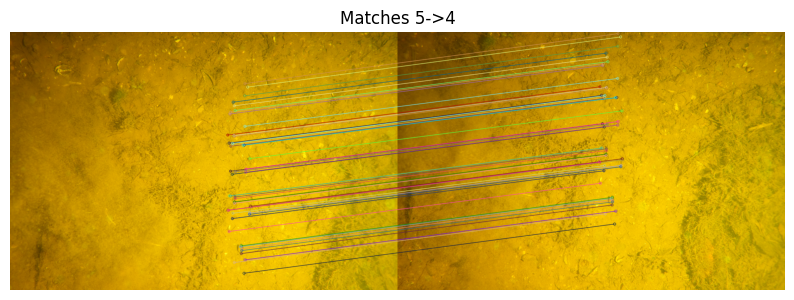

[merge] merged image 5 into canvas
[match] 6 -> 5 : 718 matches, 563 inliers


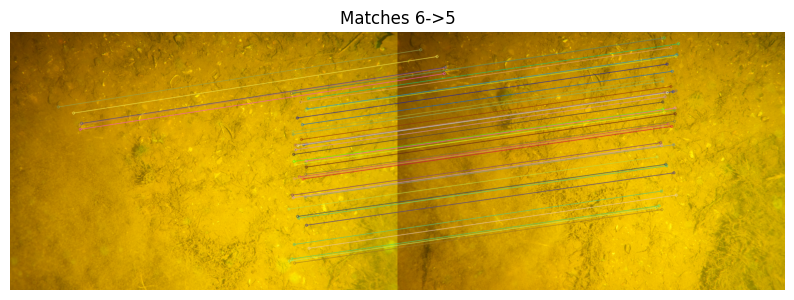

[merge] merged image 6 into canvas
[match] 7 -> 6 : 242 matches, 198 inliers


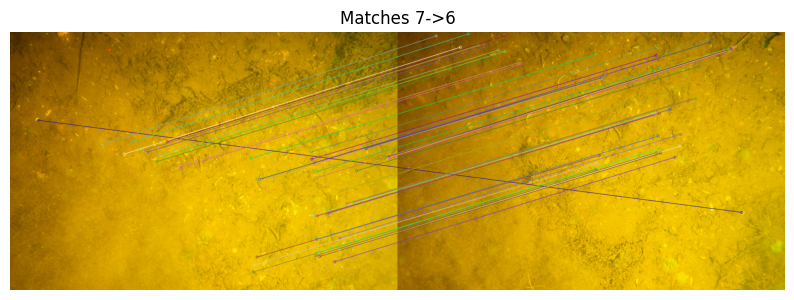

[merge] merged image 7 into canvas
[match] 8 -> 7 : 671 matches, 586 inliers


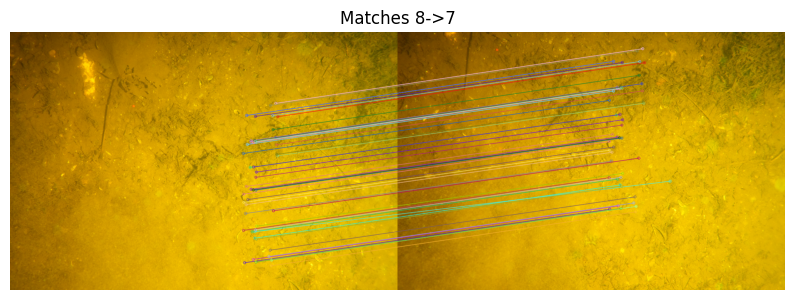

[merge] merged image 8 into canvas
[match] 3 -> 4 : 511 matches, 321 inliers


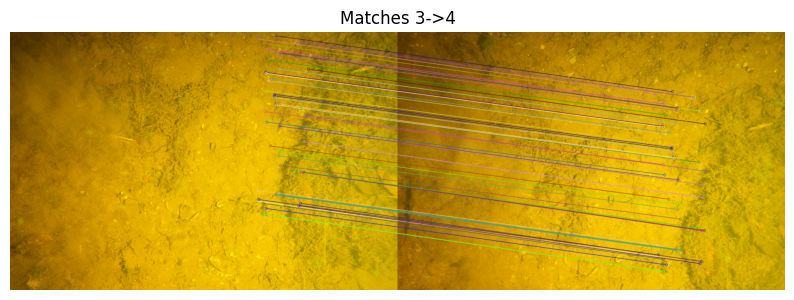

[merge] merged image 3 into canvas
[match] 2 -> 3 : 190 matches, 130 inliers


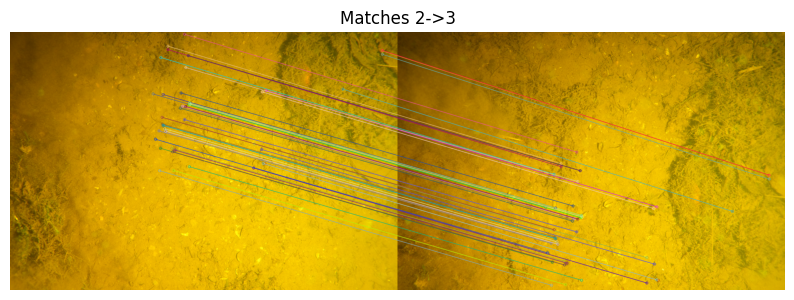

[merge] merged image 2 into canvas
[match] 1 -> 2 : 325 matches, 262 inliers


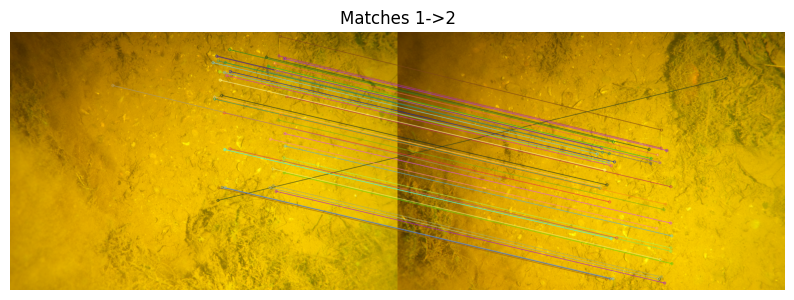

[merge] merged image 1 into canvas
[match] 0 -> 1 : 8 matches, 5 inliers


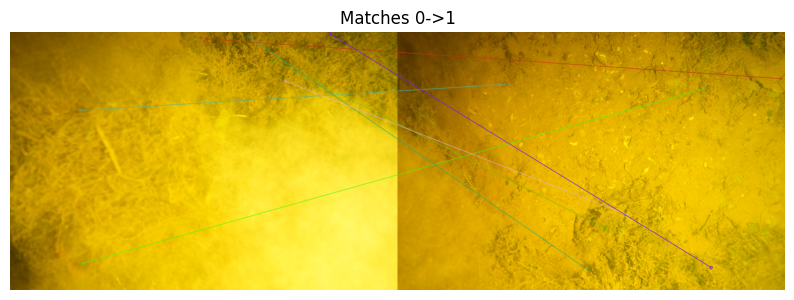

[merge] merged image 0 into canvas
[info] subgroup 2 canvas size: (3812, 2845)
[info] overlap-aware feather blending (fixed edges)
[done] wrote mosaic_2.png
[info] stitching subgroup 3 with 2 images
[match] 0 -> 1 : 31 matches, 13 inliers


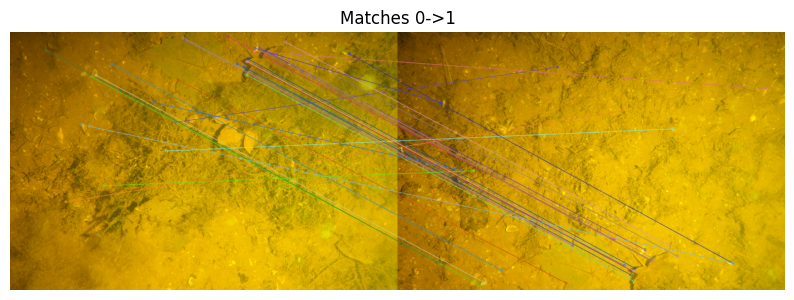

[merge] merged image 0 into canvas
[info] subgroup 3 canvas size: (1262, 1608)
[info] overlap-aware feather blending (fixed edges)
[done] wrote mosaic_3.png
[info] stitching subgroup 4 with 9 images
[match] 5 -> 4 : 17 matches, 5 inliers


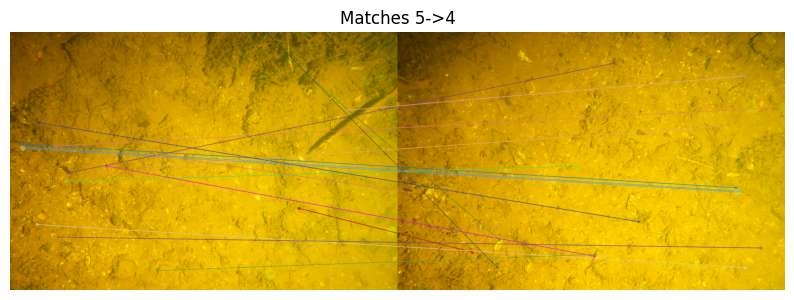

[merge] merged image 5 into canvas
[match] 6 -> 5 : 553 matches, 371 inliers


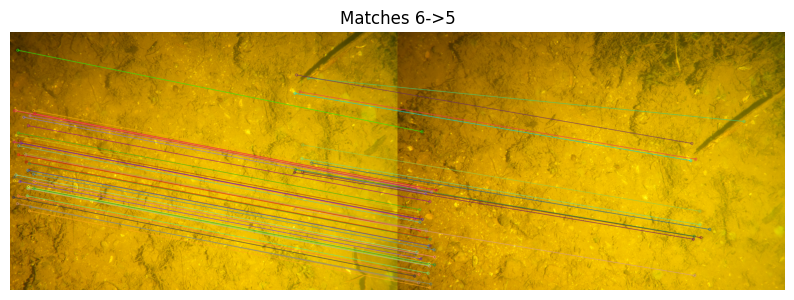

[merge] merged image 6 into canvas
[match] 7 -> 6 : 722 matches, 515 inliers


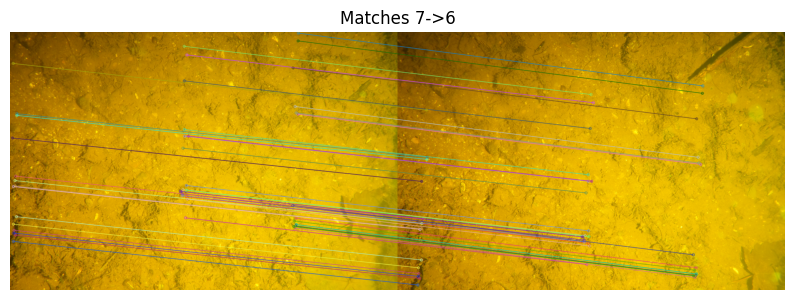

[merge] merged image 7 into canvas
[match] 8 -> 7 : 15 matches, 4 inliers


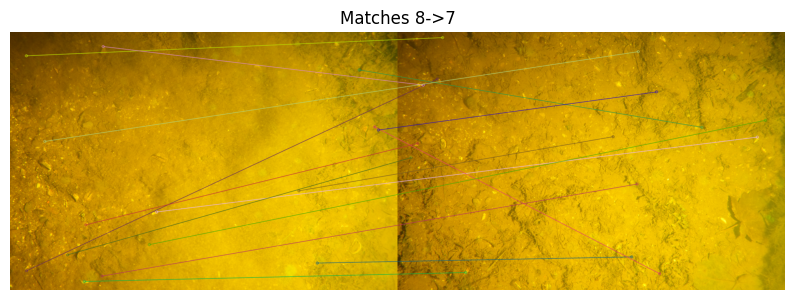

[merge] merged image 8 into canvas
[match] 3 -> 4 : 31 matches, 10 inliers


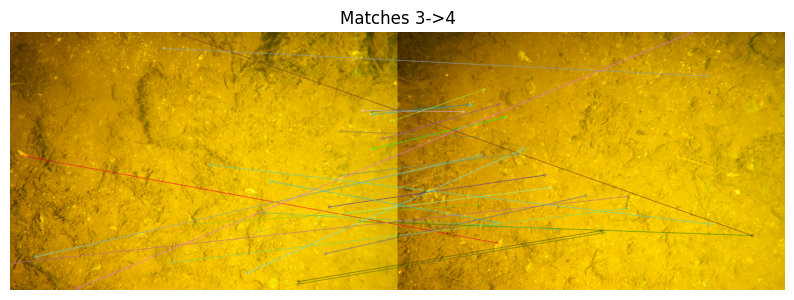

[merge] merged image 3 into canvas
[match] 2 -> 3 : 920 matches, 751 inliers


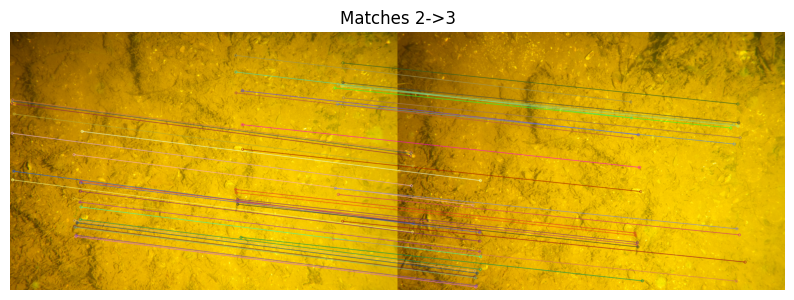

[merge] merged image 2 into canvas
[match] 1 -> 2 : 589 matches, 393 inliers


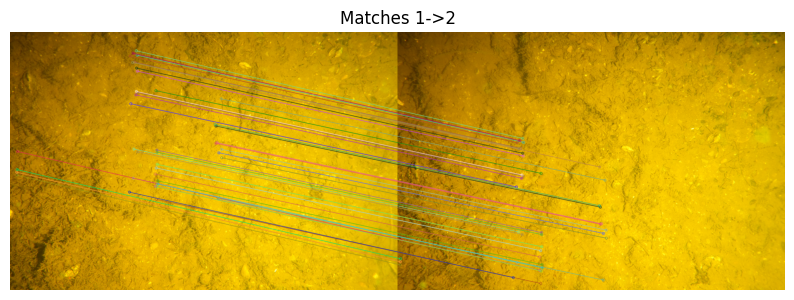

[merge] merged image 1 into canvas
[match] 0 -> 1 : 484 matches, 270 inliers


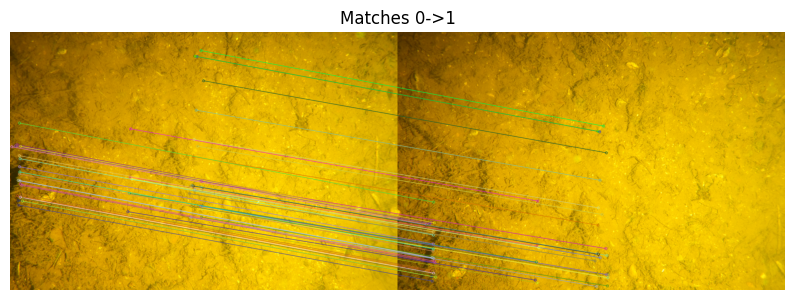

[merge] merged image 0 into canvas
[info] subgroup 4 canvas size: (3583, 1640)
[info] overlap-aware feather blending (fixed edges)
[done] wrote mosaic_4.png
[skip] subgroup 5 has only 1 image
[info] stitching subgroup 6 with 2 images
[match] 0 -> 1 : 17 matches, 14 inliers


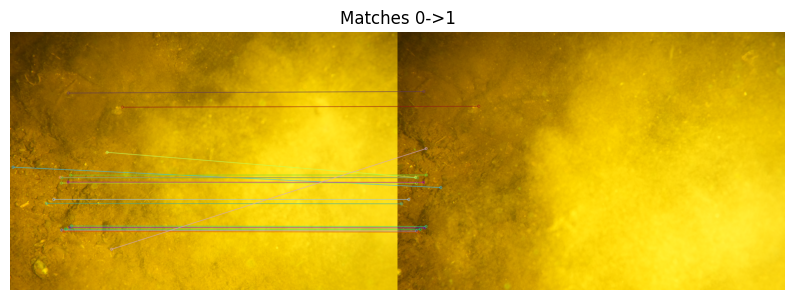

[merge] merged image 0 into canvas
[info] subgroup 6 canvas size: (1246, 840)
[info] overlap-aware feather blending (fixed edges)
[done] wrote mosaic_6.png
[info] stitching subgroup 7 with 17 images
[match] 9 -> 8 : 790 matches, 516 inliers


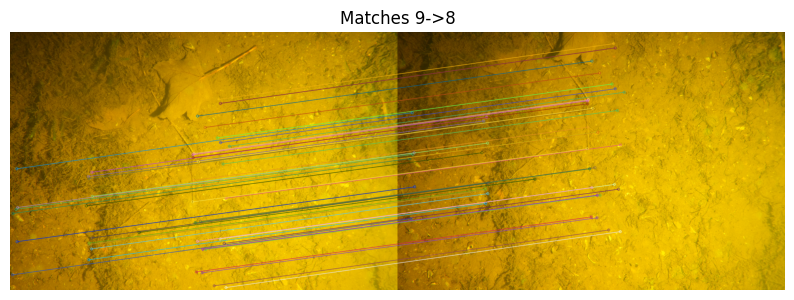

[merge] merged image 9 into canvas
[match] 10 -> 9 : 463 matches, 274 inliers


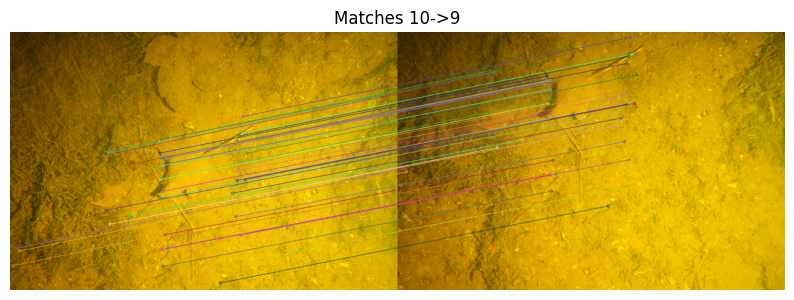

[merge] merged image 10 into canvas
[match] 11 -> 10 : 130 matches, 72 inliers


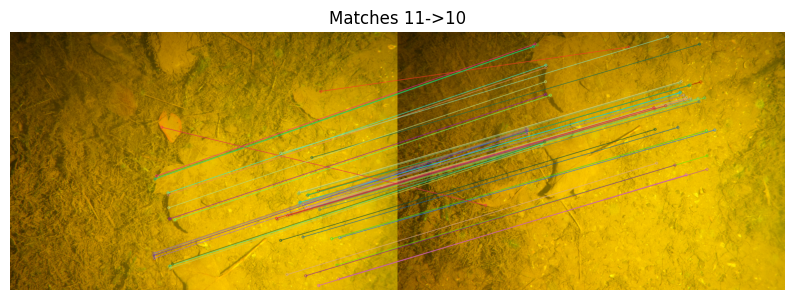

[merge] merged image 11 into canvas
[match] 12 -> 11 : 601 matches, 500 inliers


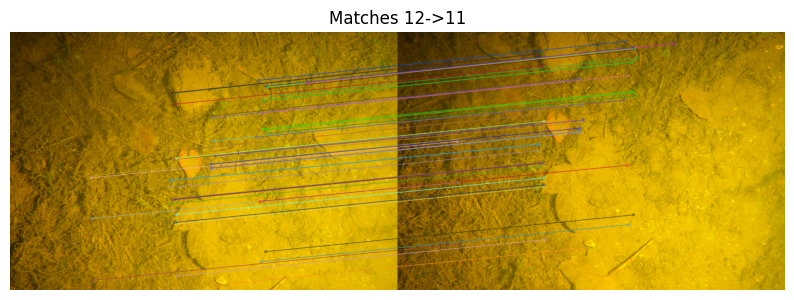

[merge] merged image 12 into canvas
[match] 13 -> 12 : 1348 matches, 1338 inliers


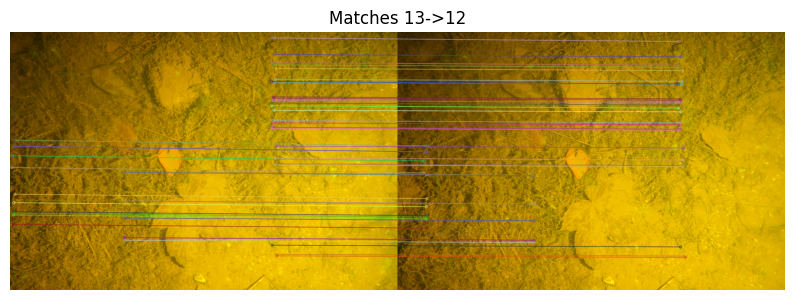

[merge] merged image 13 into canvas
[match] 14 -> 13 : 34 matches, 19 inliers


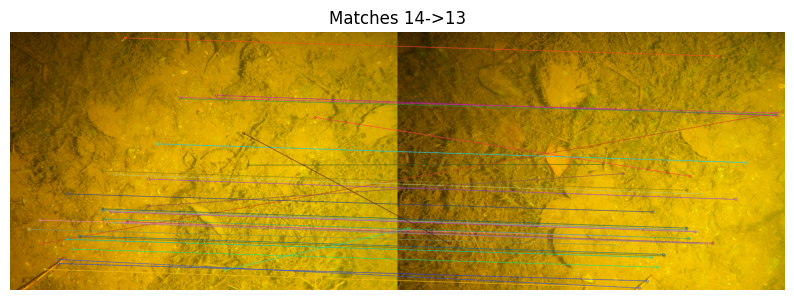

[merge] merged image 14 into canvas
[match] 15 -> 14 : 375 matches, 251 inliers


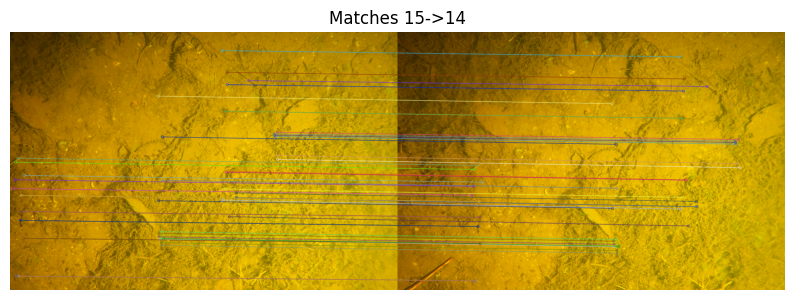

[merge] merged image 15 into canvas
[match] 16 -> 15 : 48 matches, 20 inliers


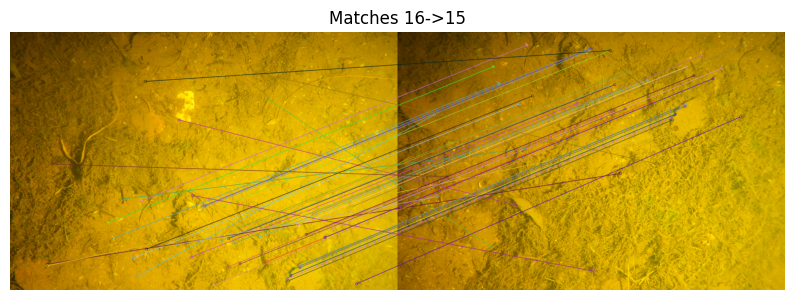

[merge] merged image 16 into canvas
[match] 7 -> 8 : 930 matches, 606 inliers


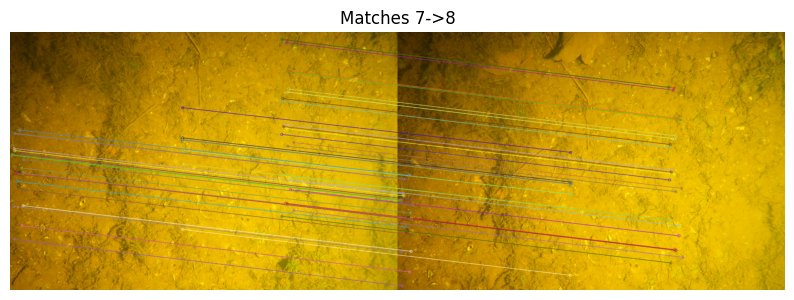

[merge] merged image 7 into canvas
[match] 6 -> 7 : 951 matches, 764 inliers


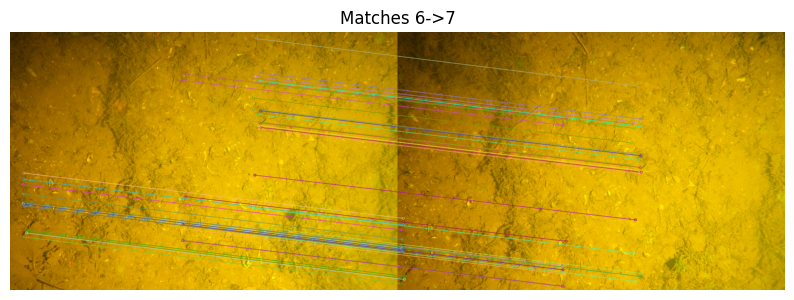

[merge] merged image 6 into canvas
[match] 5 -> 6 : 312 matches, 161 inliers


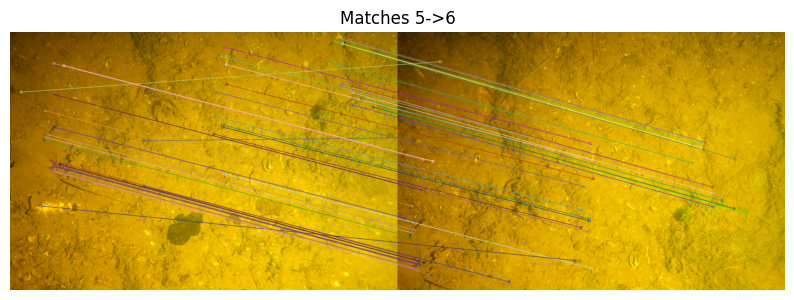

[merge] merged image 5 into canvas
[match] 4 -> 5 : 932 matches, 713 inliers


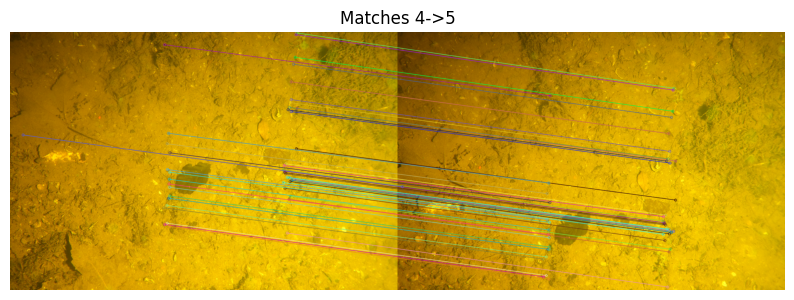

[merge] merged image 4 into canvas
[match] 3 -> 4 : 1129 matches, 787 inliers


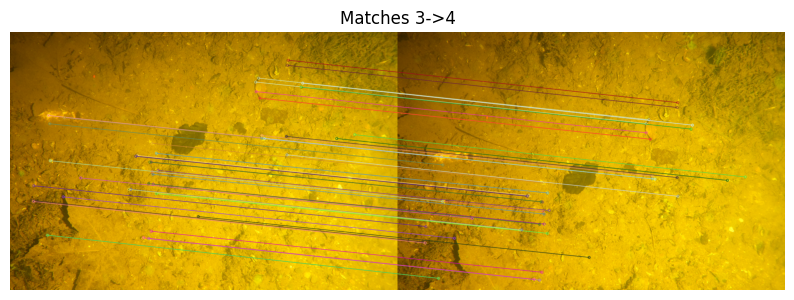

[merge] merged image 3 into canvas
[match] 2 -> 3 : 57 matches, 29 inliers


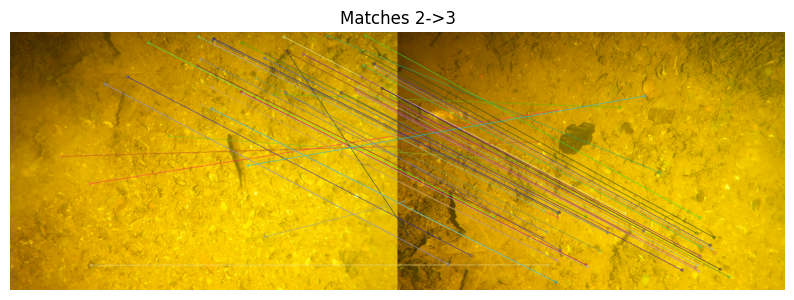

[merge] merged image 2 into canvas
[match] 1 -> 2 : 76 matches, 60 inliers


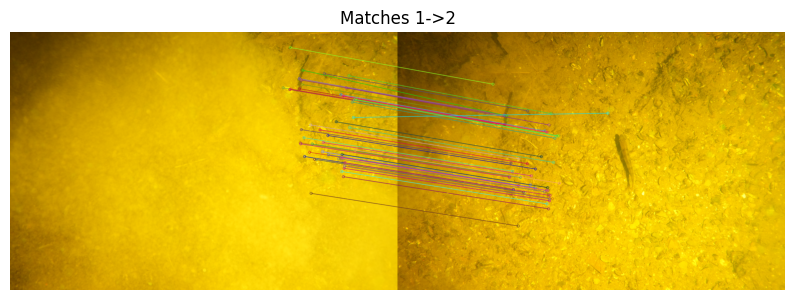

[merge] merged image 1 into canvas
[match] 0 -> 1 : 25 matches, 20 inliers


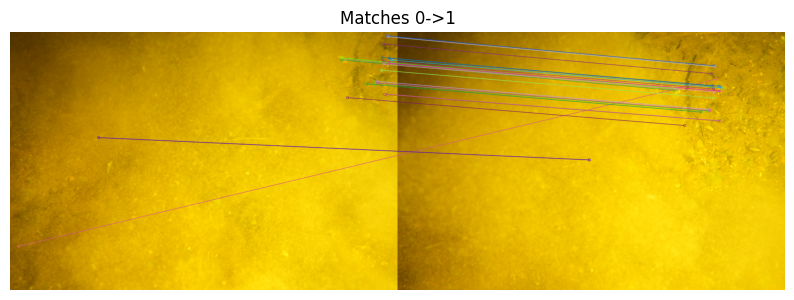

[merge] merged image 0 into canvas
[info] subgroup 7 canvas size: (9115, 8464)
[info] overlap-aware feather blending (fixed edges)
[done] wrote mosaic_7.png
[info] stitching subgroup 8 with 24 images
[match] 13 -> 12 : 1402 matches, 1193 inliers


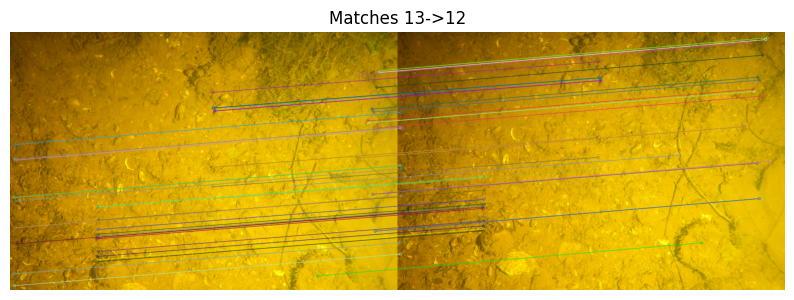

[merge] merged image 13 into canvas
[match] 14 -> 13 : 1091 matches, 766 inliers


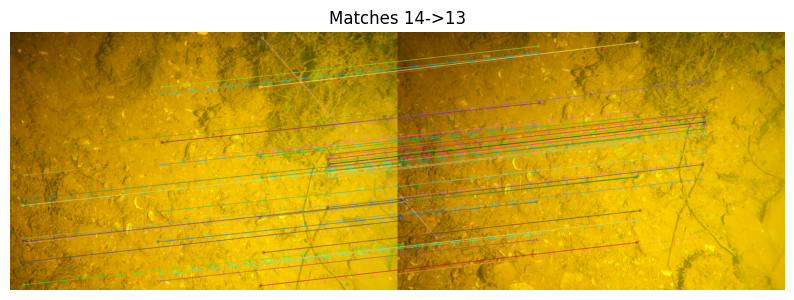

[merge] merged image 14 into canvas
[match] 15 -> 14 : 64 matches, 45 inliers


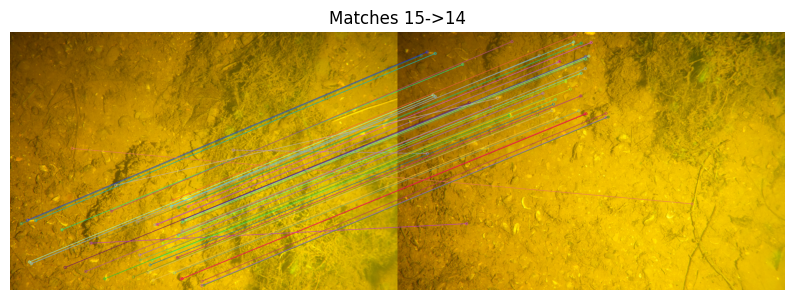

[merge] merged image 15 into canvas
[match] 16 -> 15 : 318 matches, 163 inliers


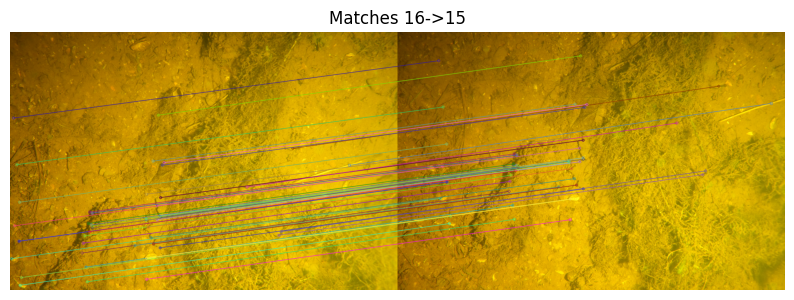

[merge] merged image 16 into canvas
[match] 17 -> 16 : 347 matches, 205 inliers


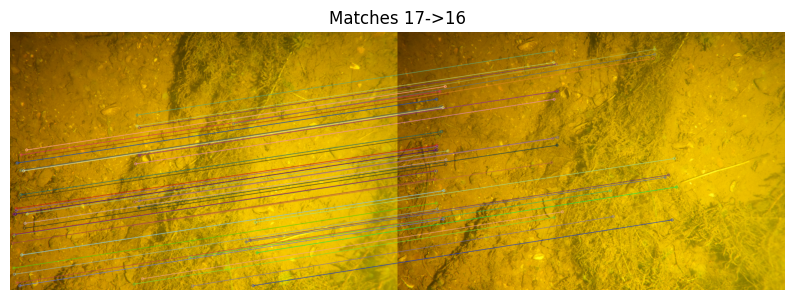

[merge] merged image 17 into canvas
[match] 18 -> 17 : 658 matches, 440 inliers


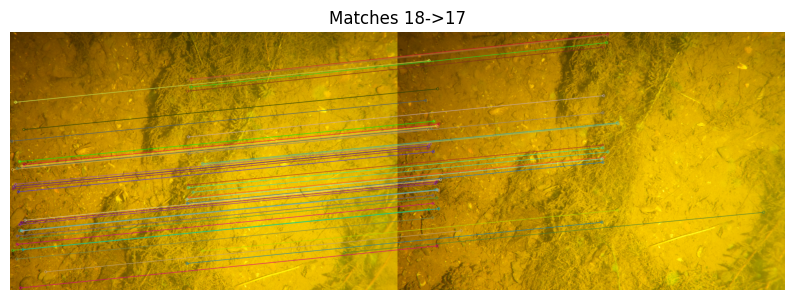

[merge] merged image 18 into canvas
[match] 19 -> 18 : 957 matches, 805 inliers


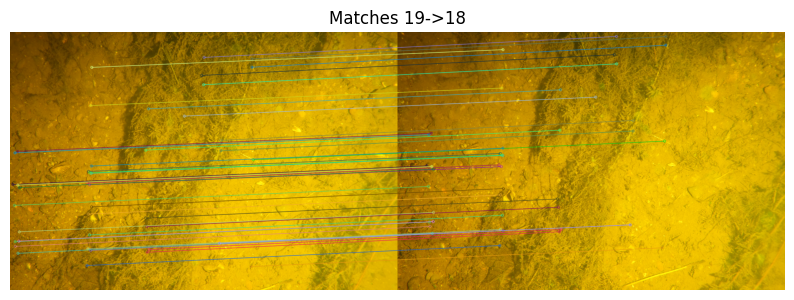

[merge] merged image 19 into canvas
[match] 20 -> 19 : 200 matches, 116 inliers


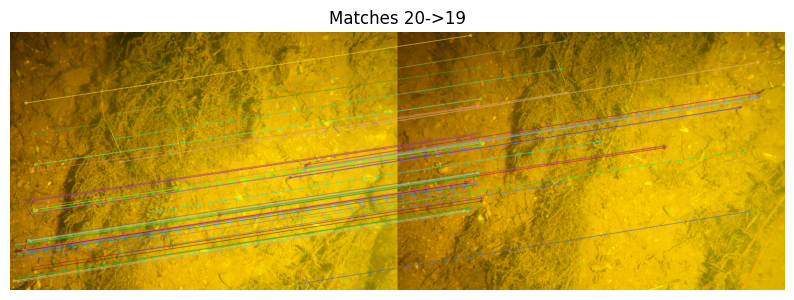

[merge] merged image 20 into canvas
[match] 21 -> 20 : 697 matches, 416 inliers


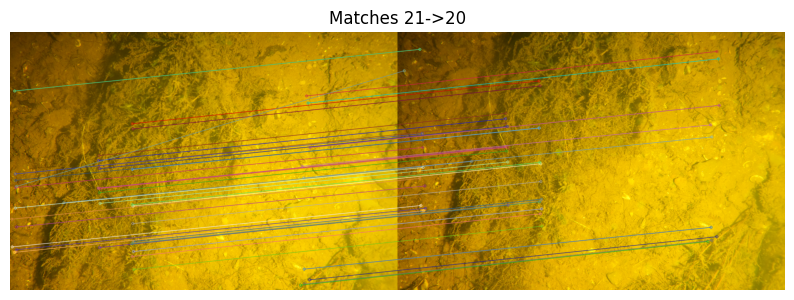

[merge] merged image 21 into canvas
[match] 22 -> 21 : 92 matches, 31 inliers


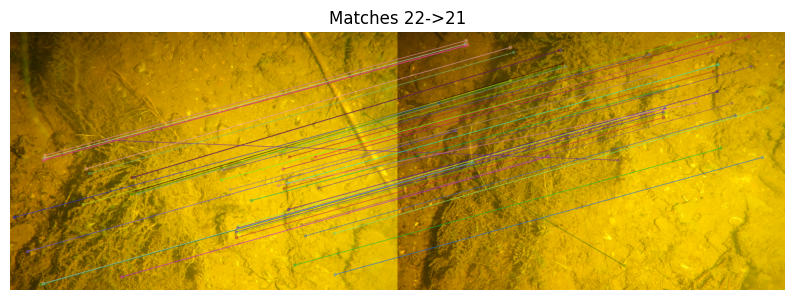

[merge] merged image 22 into canvas
[match] 23 -> 22 : 232 matches, 108 inliers


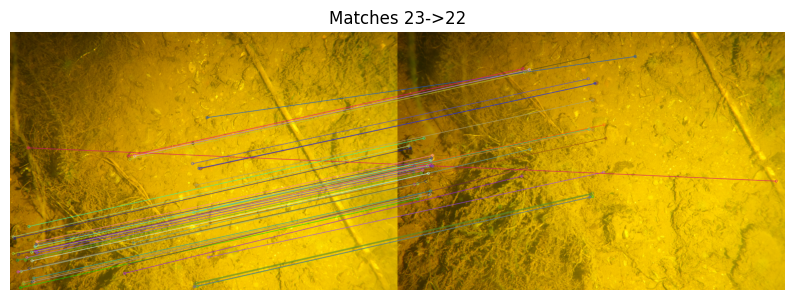

[merge] merged image 23 into canvas
[match] 11 -> 12 : 343 matches, 199 inliers


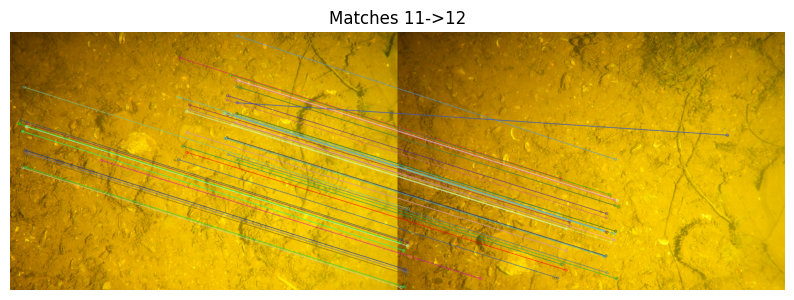

[merge] merged image 11 into canvas
[match] 10 -> 11 : 786 matches, 558 inliers


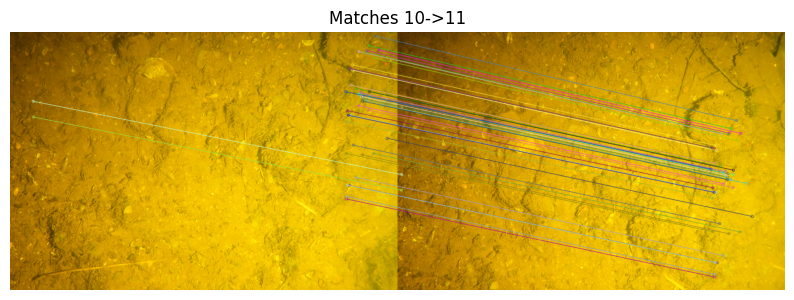

[merge] merged image 10 into canvas
[match] 9 -> 10 : 939 matches, 658 inliers


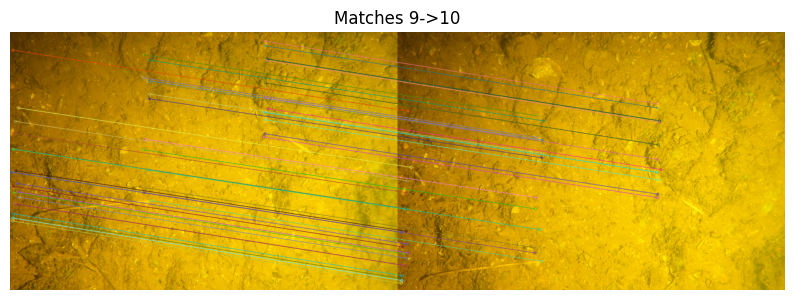

[merge] merged image 9 into canvas
[match] 8 -> 9 : 1018 matches, 686 inliers


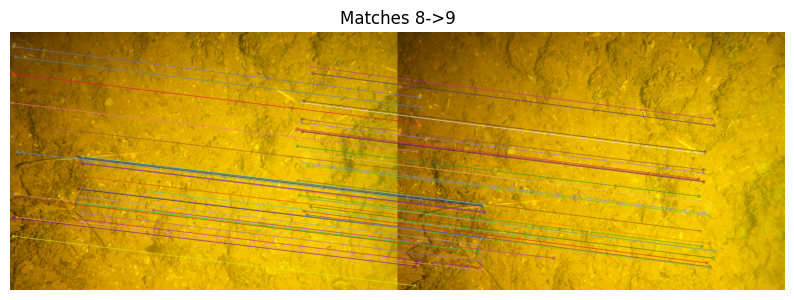

[merge] merged image 8 into canvas
[match] 7 -> 8 : 841 matches, 490 inliers


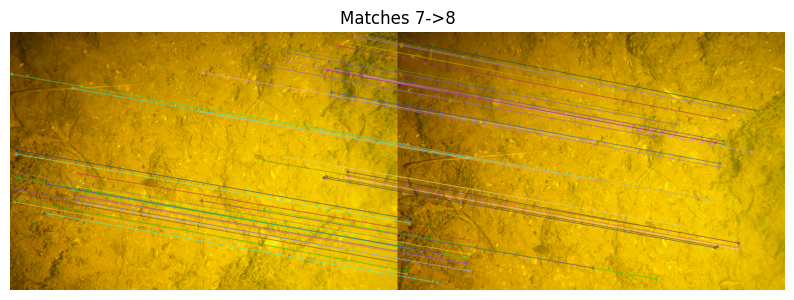

[merge] merged image 7 into canvas
[match] 6 -> 7 : 53 matches, 26 inliers


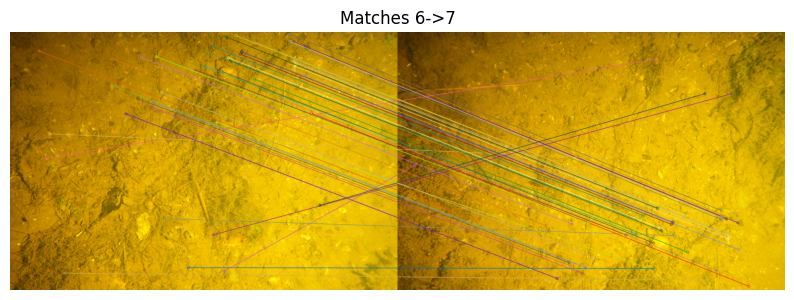

[merge] merged image 6 into canvas
[match] 5 -> 6 : 369 matches, 217 inliers


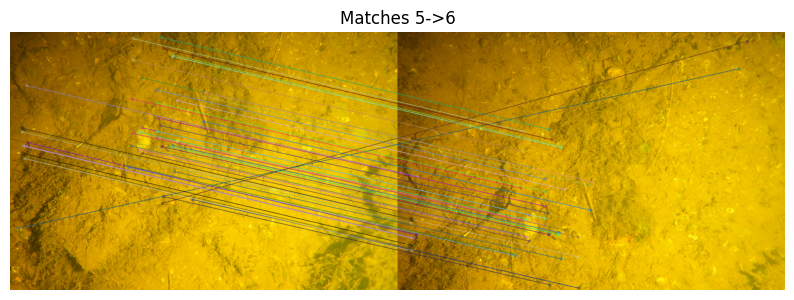

[merge] merged image 5 into canvas
[match] 4 -> 5 : 758 matches, 438 inliers


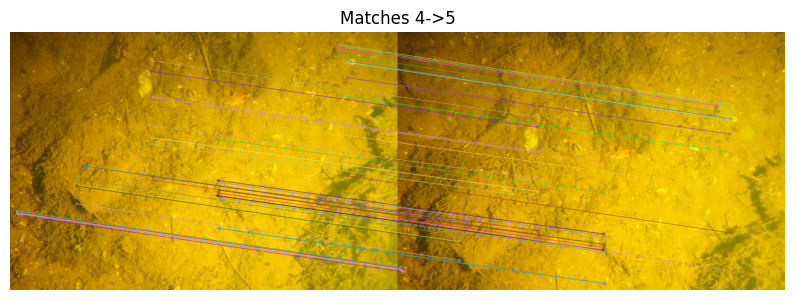

[merge] merged image 4 into canvas
[match] 3 -> 4 : 233 matches, 159 inliers


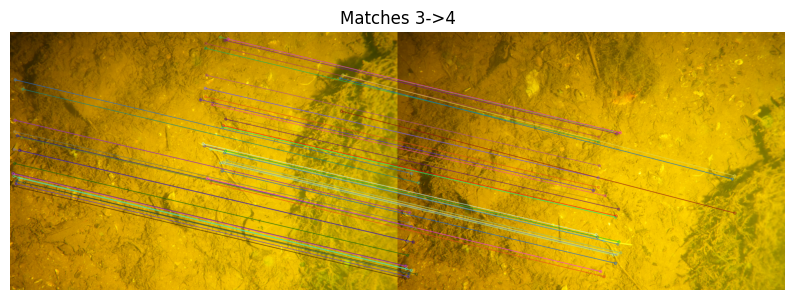

[merge] merged image 3 into canvas
[match] 2 -> 3 : 804 matches, 639 inliers


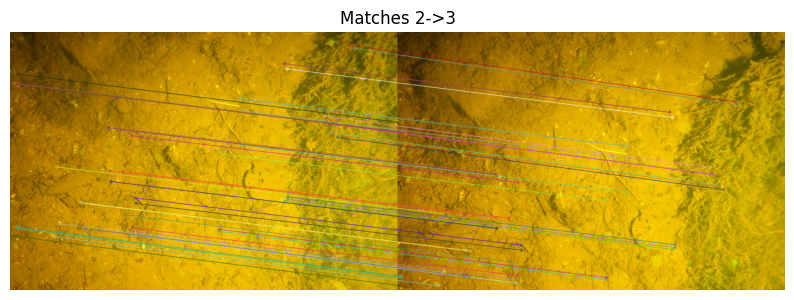

[merge] merged image 2 into canvas
[match] 1 -> 2 : 164 matches, 82 inliers


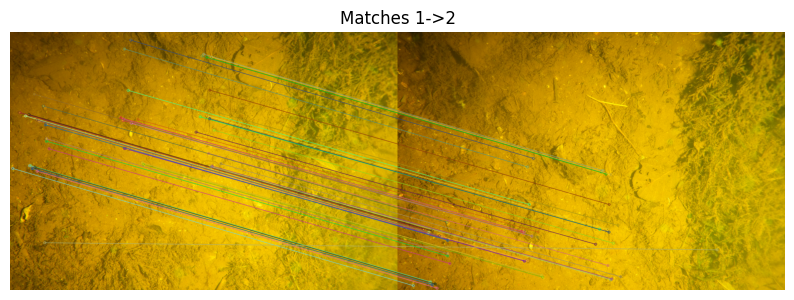

[merge] merged image 1 into canvas
[match] 0 -> 1 : 299 matches, 138 inliers


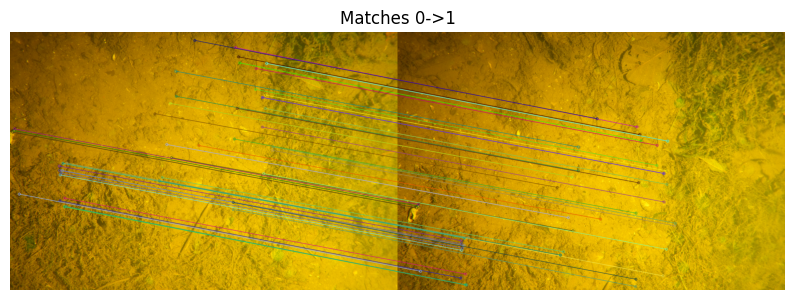

[merge] merged image 0 into canvas
[info] subgroup 8 canvas size: (164472, 371908)
[info] overlap-aware feather blending (fixed edges)


MemoryError: Unable to allocate 684. GiB for an array with shape (371908, 164472, 3) and data type float32

In [7]:
import glob
import cv2 as cv
import numpy as np

files = sorted(glob.glob("Killaloe/*.jpg"))
imgs = [imread_color(f) for f in files]
print(f"[info] loaded {len(imgs)} images")

# --- split into subgroups whenever matches fail ---
subgroups = []
current = [imgs[0]]
for i in range(1, len(imgs)):
    H, _, _, _ = detect_and_match(imgs[i], imgs[i-1], i, i-1)
    if H is None:
        print(f"[split] No match between {i-1} and {i} → new subgroup")
        subgroups.append(current)
        current = [imgs[i]]
    else:
        current.append(imgs[i])
subgroups.append(current)

print(f"[info] formed {len(subgroups)} subgroups")

# --- stitch each subgroup separately ---
for gi, group in enumerate(subgroups):
    if len(group) < 2:
        print(f"[skip] subgroup {gi} has only 1 image")
        continue

    print(f"[info] stitching subgroup {gi} with {len(group)} images")

    H_to_anchor, _ = accumulate_homographies(group)
    T, canvas_size, polys = compute_canvas_bounds(group, H_to_anchor)
    print(f"[info] subgroup {gi} canvas size: {canvas_size}")

    # visualize polygons
    # draw_polys_debug(canvas_size, group, H_to_anchor, T)

    # blend
    mosaic = multiband_blend_warped(group, H_to_anchor, T, canvas_size, debug_show=False)

    out_path = f"mosaic_{gi}.png"
    cv.imwrite(out_path, mosaic)
    print(f"[done] wrote {out_path}")
